# Capstone Project - Finding the Best Place (Week 5)
### Applied Data Science Capstone by Denis

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Target Audience](#tartget)
* [Data](#data)
    * [Data Gathering](#datagathering)
    * [Neighborhood Candidates](#neighborhood_candidates)
    * [Grid System](#neighborhood_candidates)
    * [Data Gathering](#datagathering)
    * [Data Gathering - Conclusion](#datagathering_conclusion)
* [Methodology](#methodology)
* [Analysis](#analysis)
    * [Understaning Until Now](#understanding_until_now)
    * [Dorchester & Allston-Brighton Analysis](#dorchester_allstonbrighton)
    * [Dorchester](#dorchester)
    * [Allston-Brighton](#allston_brighton)
    * [Clustering](#clustering)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)



## Introduction: Business Problem <a name="introduction"></a>

#### **Problem Statement:** Identify a location to start an Electronics Repair Shop close to homeowners and away from Downtown Boston.

Boston is the capital and largest city of Massachusetts, its popularity and high education system put it among the 25 most populous cities in the United States with an estimated population of 694,583. Founded in 1630, Boston is one of the oldest cities in the United States. Nowadays, Boston is considered to be a world leader in innovation and entrepreneurship, also, its education system attracts students from all over the globe.

This model will try to determine the best **location to start a new business ~5Km away from City Center** and target homeowners that may suffer from heavy traffic and travel long distances to Downtown just to get their devices fixed. We also expect to identify **locations that are not already crowded with electronic repair shops** or **regions without any competitor** with **a great number of houses/apartments** and **easy access by customers** nearby. 

Here, Data Science aids to identify the most promising areas based on the aforementioned criteria. And each region will be expressed so that the best possible location can be chosen.

## Target Audience <a name="target"></a>

The type of people that would be interested in this project are:

 - Business personnel who want to start an electronics repair shop into a predetermined area. This project will take a comprehensive analysis of data and information to target the best location regarding competitors and census in Boston.
 - People who can take advantage of some methods used here to their analysis into finding the best location/area based on features and geolocation. 
 - Data scientists, who can take advantage of concepts, techniques, and coding to be utilized in their projects. Even, identify new ways of how to create a story to be told.

## Data <a name="data"></a>

Based on the definition of our problem, factors that will influence our decisions are:

* Top rated stores;
* Number of existing repair shops in the neighborhood; (Any type of repair shop)
* Number of competitors and distance to them;
* Map customer's satisfaction for each competitors in order to identify service quality;
* The distance from the neighborhood to the city center.

The Boston website (https://data.boston.gov/) has available for download all information utilized in this project, such as Census and neighborhood geolocation.

The following softwares/libraries will be needed to extract/generate all required information:
* python library **geopy** generates addresses and geographic coordinates for each position defined.
* **Foursquaer API** will return competitors and stores information for each location.
* python **shapely** uses Boston's coordinates to created polygons and excluded points outside or inside neighborhoods.
* python library **fuzzywuzzy** yields probabilities from text. Here, it will read companies' description and predict whether or not they are competitors.

In order to identify the best spot, we'll create a spaced grid over Boston's geolocation.

## Neighborhood Candidates<a name="neighborhood_candidates"></a>

First, let's create a latitude & longitude coordinates for centroids of our candidate neighborhoods. After positions have been defined, geopy will produce latitude & longitude for them.

In [1]:
import requests
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import folium
import pickle
from geopy.geocoders import Nominatim

In [2]:
address = 'Boston, MA, United States'

geolocator = Nominatim(user_agent="boston_explorer")
location = geolocator.geocode(address)

latitude = location.latitude
longitude = location.longitude
boston_center = (latitude, longitude)

print('Coordinate of {}: {}, {}'.format(address, latitude, longitude))

Coordinate of Boston, MA, United States: 42.3602534, -71.0582912


Both Boston's geolocation and census informations are available in the website https://data.boston.gov.
- **Census:** https://data.boston.gov/dataset/neighborhood-demographics (xlsx)
- **Geolocation:** https://data.boston.gov/dataset/boston-neighborhoods (GeoJSON)
- **Population:** https://data.boston.gov/dataset/boston-neighborhoods (csv)

In [3]:
!wget 'https://data.boston.gov/dataset/8202abf2-8434-4934-959b-94643c7dac18/resource/e684798f-e175-4ab1-8f70-ed80e4e260cc/download/boston_neighborhood_demographics_2013-2017.xlsx'
neighborhoods_file = 'http://bostonopendata-boston.opendata.arcgis.com/datasets/3525b0ee6e6b427f9aab5d0a1d0a1a28_0.csv'
boston_geo = 'http://bostonopendata-boston.opendata.arcgis.com/datasets/3525b0ee6e6b427f9aab5d0a1d0a1a28_0.geojson'

neighborhoods = pd.read_csv(neighborhoods_file)

# select the sheet with population per neighborhood
census = pd.read_excel('boston_neighborhood_demographics_2013-2017.xlsx', sheet_name='Age').dropna()

# remove unnecessary lines
census = census[['Age','Unnamed: 1','Unnamed: 7','Unnamed: 9']][3:]

census.columns = ['Name','Population','20-34 years','35-54 years']
census = census.merge(neighborhoods, on='Name')

In [4]:
lat_long = list()

for name in census['Name']:
    location = geolocator.geocode('{}, {}'.format(name, address))
    if not location:
        print('Not found geolocation: {}, {}'.format(name, address))
    if hasattr(location, 'latitude'):
        lat_long.append((name, location.latitude, location.longitude))

lat_long = pd.DataFrame(lat_long)
lat_long.columns = ['Name', 'Latitude', 'Longitude']

census = census.merge(lat_long, on='Name')
census.head(5)

Not found geolocation: Harbor Islands, Boston, MA, United States


,Name,Population,20-34 years,35-54 years,OBJECTID,Acres,Neighborhood_ID,SqMiles,ShapeSTArea,ShapeSTLength,Latitude,Longitude
0,Allston,19363,13084,1711,51,998.534479,24,1.56,4.349599e+07,37859.091242,42.355434,-71.132127
1,Brighton,51785,27399,8337,44,1840.408596,25,2.88,8.016788e+07,48787.519652,42.350097,-71.156442
2,Charlestown,18901,5738,5315,39,871.541223,4,1.36,3.796418e+07,57509.688645,42.377875,-71.061996
3,Dorchester,125947,35301,32714,48,4662.879457,6,7.29,2.031142e+08,104344.034005,42.297320,-71.074495
4,Downtown,17581,5888,3544,42,397.472846,7,0.62,1.731385e+07,34612.804441,42.355147,-71.059954


Let's generate a map with Boston's neighborhood boundaries along with their population density. Additionally, the area delimited in **red** with a **5Km radius** will be excluded from this study.

In [5]:
boston_center = 5000

map_boston = folium.Map(location=[latitude, longitude], zoom_start=11)

folium.Choropleth(
    geo_data=boston_geo, data=census, columns=['Name', 'Population'],
    key_on='feature.properties.Name', fill_opacity=0.7, line_opacity=0.2,
    fill_color='YlOrRd', legend_name='Population', bins=3, highlight=True
).add_to(map_boston)

folium.Marker(location=[latitude,longitude], popup='City Center').add_to(map_boston)

for nei, popu, lat, lon  in zip(census['Name'], census['Population'], census['Latitude'], census['Longitude']):
    location = [lat, lon]
    folium.Marker(location, popup="""<b>Neighborhood:</b> {}</br>
                                     <b>Population:</b> {}</br>""".format(nei, popu),
                  tooltip=nei).add_to(map_boston)

folium.Circle(location=[latitude,longitude],
              popup='City Center',
              radius=boston_center,
              fill_color='red', 
              color='darkred',
              fill_opacity=0.3).add_to(map_boston)

map_boston

As we can see, from 22 neighborhoods only 11 will be analyzed.

## Grid System <a name="gridsystem"></a>

To accurately calculate distances we need to create our grid of locations in the Cartesian 2D coordinate system which allows us to calculate distances in meters (not in latitude/longitude degrees). 

Bellow are functions to convert between WGS84 spherical coordinate system (latitude/longitude degrees) and UTM Cartesian coordinate system (X/Y coordinates in  meters).

In [6]:
import pyproj
import math

def lonlat_to_xy(lon, lat):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    xy = pyproj.transform(proj_latlon, proj_xy, lon, lat)
    return xy[0], xy[1]

def xy_to_lonlat(x, y):
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    lonlat = pyproj.transform(proj_xy, proj_latlon, x, y)
    return lonlat[0], lonlat[1]

def calc_xy_distance(x1, y1, x2, y2):
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx*dx + dy*dy)

print('BOSTON center longitude={}, latitude={}'.format(longitude, latitude))
x, y = lonlat_to_xy(longitude, latitude)
print('BOSTON center UTM X={}, Y={}'.format(x, y))
lo, la = xy_to_lonlat(x, y)
print('Boston center longitude={}, latitude={}'.format(lo, la))

BOSTON center longitude=-71.0582912, latitude=42.3602534
BOSTON center UTM X=-5524418.238941787, Y=9518543.356055476
Boston center longitude=-71.0582911999993, latitude=42.3602533999996


Now, we need to exclude locations within the range of 5Km from City Center. So, we need first define a list with the boundary of each neighborhood.

In [7]:
import json
from shapely.geometry import shape, Point

!wget 'http://bostonopendata-boston.opendata.arcgis.com/datasets/3525b0ee6e6b427f9aab5d0a1d0a1a28_0.geojson' -O 'boston_coordinates.geojson'

boston_geo_file = 'boston_coordinates.geojson'
boston_shapes = list()

with open(boston_geo_file,'r') as f:
    js = json.load(f)
    
for features in js['features']:
    poly = shape(features['geometry'])
    boston_shapes.append(poly)

Create a **hexagonal grid of cells**: we offset every other row, and adjust vertical row spacing so that **every cell center is equally distant from all it's neighbors** where each has a radius of 300 meters and centered 600 meters apart.

In [8]:
# City center in Cartesian coordinates
boston_center_x, boston_center_y = lonlat_to_xy(longitude, latitude)

# Vertical offset for hexagonal grid cells
k = math.sqrt(3) / 2

# move the area squared which is used to created the hexagon center.
# This moving will cover Boston City
x_min = boston_center_x - 18500
x_step = 600
y_min = boston_center_y - 5000 - (int(21/k)*k*600 - 12000)/2
y_step = 600 * k 

latitudes = []
longitudes = []
distances_from_center = []
xs = []
ys = []

offset_distance = 2000
# loop the number of rows
for i in range(0, int(33/k)):
    y = y_min + i * y_step
    x_offset = 300 if i%2==0 else 0
    
    # loop the number of columns
    for j in range(0, 43):
        x = x_min + j * x_step + x_offset
        distance_from_center = calc_xy_distance(boston_center_x, boston_center_y, x, y)
        
        lon, lat = xy_to_lonlat(x, y)
        point = Point(lon, lat)
        inside_boundaries = False
        
        # check if the coordinate is inside the Boston radius, if true
        # the coordinate will be discarded
        for state in boston_shapes:
            if state.contains(point):
                inside_boundaries = True
                break

        if inside_boundaries and (distance_from_center >= 5000+offset_distance):
            latitudes.append(lat)
            longitudes.append(lon)
            distances_from_center.append(distance_from_center-offset_distance)
            
            xs.append(x)
            ys.append(y)

print(len(latitudes), 'candidate neighborhood centers generated.')

549 candidate neighborhood centers generated.


Let's visualize the data we have so far: city center location and candidate neighborhood centers.

In [9]:
map_boston = folium.Map(location=[latitude, longitude], zoom_start=12)

folium.Choropleth(
    geo_data=boston_geo, key_on='feature.properties.Name', fill_color='YlOrRd',
    fill_opacity=0.7, line_opacity=0.2,
    data=census, columns=['Name', 'Population'],
).add_to(map_boston)

folium.Marker([latitude, longitude], popup='Boston').add_to(map_boston)
for lat, lon in zip(latitudes, longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, popup="lat: {}<br>lon: {}".format(lat,lon),
                        fill_color='blue', fill_opacity=1).add_to(map_boston)

map_boston

With all coordinates defined of centers of neighborhoods/areas to be evaluated, equally spaced and with more than 5Km distant from Boston City Center. Now we'll use geopy library to get addresses of those locations.

In [10]:
def get_address(latitude, longitude, verbose=False):
    try:
        geo = Nominatim(user_agent='boston')
        result = geo.geocode([latitude, longitude])
        if verbose:
            print('Disabled')
        return result.address
    except:
        return None

addr = get_address(latitude, longitude)

print('Address of [{}, {}] is: {}'.format(latitude, longitude, addr))

Address of [42.3602534, -71.0582912] is: Boston City Hall, 1, Congress Street, Dock Square, Financial District, Boston, Suffolk County, Massachusetts, 02201, United States


After get all addresses we need to remove unnecessary/redundant information.

In [11]:
print('Obtaining location addresses: ', end='')

addresses = []
for lat, lon in zip(latitudes, longitudes):
    address = get_address(lat, lon)
    if address is None:
        address = 'None Address Found'
    else:
        address = address.replace(', Boston', '').replace(', Massachusetts', '').replace(', MA', '')
        address = address.replace(', United States of America', '').replace(', United States', '')
        
    addresses.append(address)
    print(' .', end='')
    
print(' finished.')

Obtaining location addresses:  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .

Now, we need to split the addresses into lists and then create a DataFrame for each one.

In [16]:
import re

zipcode = list()
neigborhood = list()
borough = list()

for idx in range(len(addresses)):
    result = re.search(r'^(?P<addr>.+), (?P<neigh>.+), (?P<borou>[\w\d\s]+),? (?P<zip>[0-9\-]+)$', addresses[idx])
    
    if result:
        addresses[idx] = result.groupdict()['addr']
        zipcode.append(result.groupdict()['zip'])
        neigborhood.append(result.groupdict()['neigh'])
        borough.append(result.groupdict()['borou'])
    else:
        print('not found zip to: ', addresses[idx])
        zipcode.append(np.nan)
        neigborhood.append(np.nan)
        borough.append(np.nan)
        
for idx in range(len(addresses)):
    addresses[idx] = re.sub(r',$', '', addresses[idx])
        
addresses[1:4]

not found zip to:  None Address Found
not found zip to:  None Address Found
not found zip to:  Roxbury, Suffolk County, 02130-4803
not found zip to:  Roslindale, Jamaica Plain, Suffolk County


['295, Faywood Avenue, Orient Heights',
 '370, William F McClellan Highway, Orient Heights',
 '450, William F McClellan Highway, Orient Heights']

In [17]:
print('zip code shape: ', len(zipcode))
print('neigborhood shape: ', len(neigborhood))
print('borough shape: ', len(borough))
print('addresses shape: ', len(addresses))

zip code shape:  549
neigborhood shape:  549
borough shape:  549
addresses shape:  549


In [18]:
df_locations = pd.DataFrame({'Address': addresses,
                             'Neigborhood': neigborhood,
                             'Borough': borough,
                             'Zipcode': zipcode,
                             'Latitude': latitudes,
                             'Longitude': longitudes,
                             'X': xs,
                             'Y': ys,
                             'Distance from City Center': distances_from_center})

df_locations.head(5)

,Address,Neigborhood,Borough,Zipcode,Latitude,Longitude,X,Y,Distance from City Center
0,"86, Boardman Street, Orient Heights",East Boston,Suffolk County,02150,42.388556,-71.011085,-5.519218e+06,9.513308e+06,5378.972434
1,"295, Faywood Avenue, Orient Heights",East Boston,Suffolk County,02128,42.392198,-71.010579,-5.518618e+06,9.513308e+06,5813.400936
2,"370, William F McClellan Highway, Orient Heights",East Boston,Suffolk County,02150,42.390702,-71.015087,-5.518918e+06,9.513828e+06,5244.892316
3,"450, William F McClellan Highway, Orient Heights",East Boston,Suffolk County,02151,42.394344,-71.014581,-5.518318e+06,9.513828e+06,5710.283047
4,"University of Massachusetts Boston, 150, Mount...",South Boston,Suffolk County,02125,42.314918,-71.034169,-5.531518e+06,9.514867e+06,5995.431548


### Foursquare API
Now that we have our location candidates, let's use Foursquare API to get info on all locations around our point, moreover, competitor and repair companies.

Foursquare credentials are defined in hidden cell bellow.

In [19]:
CLIENT_ID = 'NBT2AWG1NMJGHRHNJSARZFOWQG4E0IUYXT1XV5CO30BJXPXC' # your Foursquare ID
CLIENT_SECRET = 'FCCWKMPFFMGZXHM40HTSZ1GLHCPXO02T3Q0PXVSFOPDRK3KG' # your Foursquare Secret
VERSION = '20191110' # Foursquare API version
LIMIT = 100

## Data Gathering <a name="datagathering"></a>

We couldn't find a specific category into Foursquare for Electronic Repair Shops, so we will have to read detailed information about each company registered as **Other Repair Shop**, **home service**, and **IT Services** and check if there are competitors. 

All companies categorized as **Mobile Phone Shop** and **Electronics Store** will be considered competitor, this is done due to scarce companies found and after fast research from API results, we were able to identify that these companies goal are very likely the same that our customers' goal. In order to classify a company as a competitor the library **fuzzywuzzy** reads their information and gives a probability of it be a competitor.  

Companies are classified as the following:
 - **Competitor:** direct competitors.
 - **General Repair:** company which does fixing services, such as, plumbing and does not represent a threat for the business, rather, we can make a partnership.
 - **Stores:** all remaining companies.
 ---

The list **repair_shop_words** is a group of words used to characterize a company as a competitor. According to our tests, a result of 70% probability is very likely to be one. While the function **get_competitor_data** will gather more information about competitors.

In [194]:
from fuzzywuzzy import fuzz

# narrow down similar companies and competitors from general comapnies.
repair_shop_categories = ['52f2ab2ebcbc57f1066b8b2f', #other repair shop
                          '545419b1498ea6ccd0202f58', #home service
                          '52f2ab2ebcbc57f1066b8b36' #it services
                         ]

# compare against possible competitors
repair_shop_words = ['iphone repair',
                     'computer repair', 
                     'laptop repair', 
                     'cell phone repair', 
                     'tv repair', 
                     'electronic repair']


def check_repair_shop(categories, category_filter):
    
    competitor_shop_categories = ["4f04afc02fb6e1c99f3db0bc", #Mobile Phone Shop
                                  "4bf58dd8d48988d122951735" #Electronics Store
                                 ]
    is_repair_shop = False
    is_competitor = False
    
    for c in categories:
        category_name = c[0].lower()
        category_id = c[1]
        
        if category_id in category_filter:
            is_repair_shop = True
    
        if category_id in competitor_shop_categories:
            is_competitor = True
            is_repair_shop = True
            
    return is_repair_shop, is_competitor


def get_competitor_data(venue_id, client_id, client_secret, version, competitor=False):
    data = {}
    is_competitor = True if competitor else False
    
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
        venue_id,
        client_id,
        client_secret,
        version)
    try:
        results = requests.get(url).json()['response']['venue']
    except:
        print('+', end='')
        return is_competitor, {}
        
    data['description'] = results.get('description', '')
    data['rating'] = results.get('rating', 0)
    data['likes'] = results['likes'].get('count', 0)
    data['popular'] = results.get('popular', 0)
    data['checkins'], data['visits'] = get_stats(results['stats'])
    data['price'] = results.get('price', np.nan)
    data['url'] = results.get('ur', np.nan)
    data['tips_count'] = results['tips'].get('count', 0)
    data['photos_count'] = results['photos'].get('count', 0)
    data['chain'] = 1 if results.get('venueChains') else 0
    
    if data['chain'] == 0 and data.get('page'):
        try:
            if data['page']['user']['type'].lower() == 'chain':
                data['chain'] = 1
        except:
            pass
    
    if not(is_competitor):
        result=[]
        for query in repair_shop_words:
            r = fuzz.partial_ratio(query, data['description'].lower())
            result.append(r)
        if np.mean(result) >= 70 or any(v>=70 for v in result):
            is_competitor = True
        
        if not(is_competitor):
            result=[]
            for query in repair_shop_words:
                r = fuzz.token_set_ratio(query, results['name'])
                result.append(r)
            if any(v > 70 for v in result):
                is_competitor = True
                
    return is_competitor, data


def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]


def get_stats(stats):
    return stats.get('checkinsCount', 0), stats.get('visitsCount', 0)


def get_venues_near_location(lat, lon, client_id, client_secret, version, category=None, radius=500, limit=100):
    
    params = dict(client_id=client_id, 
                  client_secret=client_secret, 
                  v=version, 
                  ll='{},{}'.format(lat, lon), 
                  radius=radius, 
                  limit=limit)
    
    if category:
        params['categoryId'] = category
        url = 'https://api.foursquare.com/v2/venues/explore'
    else:
        url = 'https://api.foursquare.com/v2/venues/explore'
    
    try:
        results = requests.get(url, params=params).json()['response']['groups'][0]['items']
        
        venues = [(item['venue']['id'],
                   item['venue']['name'],
                   get_categories(item['venue']['categories']),
                   (item['venue']['location']['lat'], 
                   item['venue']['location']['lng']),
                   item['venue']['location']['distance']) for item in results]
    except:
        print('-', end='')
        venues = []
        
    return venues


def get_trending_arround(lat, lon, radius, client_id, client_secret, version, limit):
    
    url = 'https://api.foursquare.com/v2/venues/trending'
    params = dict(ll='{},{}'.format(lat, lon),
                  radius=radius,
                  client_id=client_id,
                  client_secret=client_secret,
                  v=version,
                  limit=limit)

    try:
        result = requests.get(url, params=params).json()['reponse']['venues']
        venues = [(item['id'],
                   item['name'],
                   item['location']['lat'],
                   item['location']['lng'],
                   get_categories(item['categories']),
                  
                  ) for item in results]
    except:
        venues= []
    
    return venues


def get_similar_companies(venue_id, client_id, client_secret, verion, limit):
    
    url = 'https://api.foursquare.com/v2/venues/{}/similar'.format(venue_id)
    
    params = dict(client_id=client_id,
                 client_secret=client_secret,
                 limit=limit,
                 v=version)
    
    try:
        results = requests.get(url, params=params).json()["response"]["similarVenues"]
        companies = {}
        count = results.get("count",0)
        if count>0:
            for c in results["items"]:
                idx =c["id"]
                companies[idx] = {}
                companies[idx]['id'] = idx
                companies[idx]['name'] = c["name"]
                companies[idx]['lat'] = c["location"]["lat"]
                companies[idx]['lon'] = c["location"]["lng"]
                companies[idx]['category'] = list()
                
                for n in c[idx]['categories']:
                    companies[idx]['category'].append(n['name'])
                
                if c.get('stats'):
                    companies[idx]['tips_count'] = c["stats"].get("tipCount",0)
                    companies[idx]['users_count'] = c["stats"].ge("usersCount",0)
                    companies[idx]['checkins'] = c["stats"].get("checkinsCount",0)
                else:
                    companies[idx]['tips_count'] = 0
                    companies[idx]['users_count'] = 0
                    companies[idx]['checkins'] = 0
      
        else:
            return None
    except:
        return None


In [21]:
# Let's now go over our neighborhood locations and get nearby restaurants; we'll also maintain a dictionary of all found restaurants and all found italian restaurants
def get_stores(neighs, lats, lons, client_id, client_secret, version, limit):
    stores = {}
    general_repair_shops = {}
    competitor_repairs = {}

    print('Obtaining venues around candidate locations:', end='')
    for neigh, lat, lon in zip(neighs, lats, lons):
        # Using radius=350 to meke sure we have overlaps/full coverage so we don't miss any restaurant (we're using dictionaries to remove any duplicates resulting from area overlaps)
        venues = get_venues_near_location(lat, lon, 
                                          client_id, 
                                          client_secret, 
                                          version,
                                          limit=limit, 
                                          radius=350)

        for venue in venues:
            venue_id = venue[0]
            venue_name = venue[1]
            venue_categories = venue[2]
            venue_latlon = venue[3]
            venue_central_location = (lat, lon)
            venue_central_distance = venue[4]
            
            # can miss some competitors
            is_repair, is_competitor = check_repair_shop(venue_categories, repair_shop_categories)
            
            x, y = lonlat_to_xy(venue_latlon[1], venue_latlon[0])
            
            # check again competitors
            competitor_data = {}
            if is_repair:
                is_competitor, competitor_data = get_competitor_data(venue_id, 
                                                                     client_id, 
                                                                     client_secret, 
                                                                     version, 
                                                                     is_competitor)

            store = {'neighborhood': neigh, 
                     'id': venue_id, 
                     'name': venue_name,
                     'category': venue_categories,
                     'latitude': venue_latlon[0], 
                     'longitude': venue_latlon[1], 
                     'cartisian_x': x, 
                     'cartisian_y': y,
                     'central_point': venue_central_location,
                     'central_distance': venue_central_distance}
            
            #merge dicts
            if competitor_data:
                store = {**store, **competitor_data}
            
            
            if is_competitor:
                competitor_repairs[venue_id] = store
            elif not(is_competitor) and is_repair:
                general_repair_shops[venue_id] = store
            else:
                stores[venue_id] = store
                
        print(' .', end='')
        
    print(' done.')
    return stores, general_repair_shops, competitor_repairs


stores = {}
general_repair_shops = {}
competitor_repairs = {}

try:
    with open('capstone_stores.pkl', 'rb') as f:
        stores = pickle.load(f)
    with open('capstone_general_repair_shops.pkl', 'rb') as f:
        general_repair_shops = pickle.load(f)
    with open('capstone_competitor_repairs.pkl', 'rb') as f:
        competitor_repairs = pickle.load(f)        

except:
    stores, general_repair_shops, competitor_repairs = get_stores(df_locations['Neigborhood'],
                                                              df_locations['Latitude'], 
                                                              df_locations['Longitude'], 
                                                              CLIENT_ID, 
                                                              CLIENT_SECRET, 
                                                              VERSION,
                                                              LIMIT)

In [ ]:
with open('capstone_stores.pkl', 'wb') as f:
    pickle.dump(stores, f)
with open('capstone_general_repair_shops.pkl', 'wb') as f:
    pickle.dump(general_repair_shops, f)
with open('capstone_competitor_repairs.pkl', 'wb') as f:
    pickle.dump(competitor_repairs, f)

In [23]:
print('Total number of Shops:', len(stores))
print('Total number of General Repair Shop:', len(general_repair_shops))
print('Total number of Competitors:', len(competitor_repairs))
print('Percentage of Competitors: {:.2f}%'.format(len(competitor_repairs) / (len(stores)+len(general_repair_shops)+len(competitor_repairs)) * 100))

Total number of Shops: 1609
Total number of General Repair Shop: 13
Total number of Competitors: 16
Percentage of Electronic Repair Shop: 0.98%


In [27]:
print('================ Shops ====================')
print('Shape: ', pd.DataFrame(stores.values()).shape)
pd.DataFrame(stores.values()).head(5)

================ Shops ====================
Shape:  (1609, 10)


,neighborhood,id,name,category,latitude,longitude,cartisian_x,cartisian_y,central_point,central_distance
0,East Boston,55d32677498e12fc85b37dcb,Hilton Garden Inn Boston Logan Airport,"[(Hotel, 4bf58dd8d48988d1fa931735)]",42.389737,-71.012203,-5.519040e+06,9.513463e+06,"(42.39070154372432, -71.0150867992004)",260
1,East Boston,4bda1e122a3a0f47d8dfa9b6,Constitution Beach,"[(Beach, 4bf58dd8d48988d1e2941735)]",42.389498,-71.007469,-5.519020e+06,9.512887e+06,"(42.38855586012358, -71.01108482919213)",315
2,East Boston,4e4dec56bd41b76bef9567b8,SUBWAY,"[(Sandwich Place, 4bf58dd8d48988d1c5941735)]",42.386340,-71.009262,-5.519557e+06,9.513050e+06,"(42.38855586012358, -71.01108482919213)",288
3,East Boston,4c524a7099ecc9b62805aa5a,El Kiosko,"[(Bar, 4bf58dd8d48988d116941735)]",42.387021,-71.007710,-5.519426e+06,9.512874e+06,"(42.38855586012358, -71.01108482919213)",325
4,East Boston,4bb763a3941ad13a299520e3,Starbucks,"[(Coffee Shop, 4bf58dd8d48988d1e0931735)]",42.392029,-71.013201,-5.518678e+06,9.513622e+06,"(42.39434376855334, -71.01458125757644)",281


In [26]:
print('=========== General Repair shops ================')
print('Shape: ', pd.DataFrame(general_repair_shops.values()).shape)
pd.DataFrame(general_repair_shops.values()).head(5)

=========== General Repair shops ================
(13, 21)


,neighborhood,id,name,category,latitude,longitude,cartisian_x,cartisian_y,central_point,central_distance,...,rating,likes,popular,checkins,visits,price,url,tips_count,photos_count,chain
0,Dorchester,4dceb3e36365b85295722985,APC Integrated,"[(IT Services, 52f2ab2ebcbc57f1066b8b36)]",42.292659,-71.050494,-5.535355e+06,9.516474e+06,"(42.2922494151415, -71.0501549508595)",53,...,0.0,1.0,0.0,0.0,0.0,NaN,NaN,1.0,1.0,0.0
1,Dorchester,51e4b454454a89a422bcc1ae,Owencroft Plumbing and Heating,"[(Home Service, 545419b1498ea6ccd0202f58)]",42.280198,-71.069419,-5.537625e+06,9.518562e+06,"(42.28112981262991, -71.0731000575377)",320,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
2,Dorchester,5006b8251648d928a90496d3,TopTen Hardwood Floors,"[(Home Service, 545419b1498ea6ccd0202f58)]",42.279404,-71.076243,-5.537839e+06,9.519376e+06,"(42.27963200387834, -71.0775875733803)",113,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
3,Dorchester,4ec197e54fc6a7630f6f71e9,Economy Plumbing & Heating Supply,"[(Home Service, 545419b1498ea6ccd0202f58)]",42.279976,-71.085164,-5.537855e+06,9.520468e+06,"(42.28027016981259, -71.08606556322958)",81,...,0.0,1.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
4,Dorchester,511155d890e7211a27071e83,Blue Hill Emergency Plumbing,"[(Home Service, 545419b1498ea6ccd0202f58)]",42.270609,-71.089783,-5.539443e+06,9.520874e+06,"(42.2715022113691, -71.09154210419084)",175,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0


In [31]:
print('================ Competitors around location =====================')
print('Shape: ', pd.DataFrame(competitor_repairs.values()).shape)
pd.DataFrame(competitor_repairs.values()).head(5)

================ Competitors around location =====================
Shape:  (16, 21)


,neighborhood,id,name,category,latitude,longitude,cartisian_x,cartisian_y,central_point,central_distance,...,rating,likes,popular,checkins,visits,price,url,tips_count,photos_count,chain
0,Dorchester,4cb331e4c5e6a1cd9aedeaf6,Verizon,"[(Mobile Phone Shop, 4f04afc02fb6e1c99f3db0bc)]",42.285128,-71.044577,-5.536512e+06,9.515630e+06,"(42.28647461605053, -71.04666542815158)",228,...,6.6,4.0,0,0.0,0.0,NaN,NaN,2.0,5.0,0.0
1,Dorchester,57b48e7c498efe24586405cc,AT&T,"[(Mobile Phone Shop, 4f04afc02fb6e1c99f3db0bc)]",42.283564,-71.050094,-5.536836e+06,9.516273e+06,"(42.28497883235248, -71.0511552889278)",180,...,6.6,0.0,0,0.0,0.0,NaN,NaN,0.0,12.0,0.0
2,Dorchester,4e5fd47d62e16ff820f9aa64,At&t - One Solution Wireless,"[(Electronics Store, 4bf58dd8d48988d122951735)]",42.283380,-71.050192,-5.536868e+06,9.516282e+06,"(42.28497883235248, -71.0511552889278)",194,...,0.0,0.0,0,0.0,0.0,NaN,NaN,1.0,0.0,0.0
3,Dorchester,4e67acf0bd41e96a148c2510,T-Mobile,"[(Mobile Phone Shop, 4f04afc02fb6e1c99f3db0bc)]",42.291360,-71.046663,-5.535520e+06,9.515987e+06,"(42.2922494151415, -71.0501549508595)",304,...,6.7,0.0,0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
4,South Boston,589dbd783ef0f60d6893c206,T-Mobile,"[(Mobile Phone Shop, 4f04afc02fb6e1c99f3db0bc)]",42.317073,-71.056464,-5.531443e+06,9.517604e+06,"(42.31684982589067, -71.05963396087319)",262,...,6.7,0.0,0,0.0,0.0,NaN,NaN,0.0,3.0,0.0


### Data Gathering - Conclusion<a name="datagathering_conclusion"></a>
Now that we have all competitors and general repair surrounding our locations identified we need to know which stores are in the vicinity of every neighborhood candidate center. Finally, we'll use this data for analysis to produce the report on optimal locations for our business!

Company Colors:
 * <b>Red: </b>Competitor
 * <b>Yellow: </b>General Repair/Fixing Shop
 * <b>Blue: </b> Neutral store

In [32]:
import itertools

map_boston = folium.Map(location=[latitude, longitude], zoom_start=12)
folium.Marker(location=[latitude,longitude], popup='City Center').add_to(map_boston)

folium.Choropleth(geo_data=boston_geo, key_on='feature.properties.Name', fill_opacity=0.7, line_opacity=0.2,
        data=census, columns=['Name', 'Population'], fill_color='YlOrRd').add_to(map_boston)

for store in itertools.chain(stores.values(),
                             general_repair_shops.values(),
                             competitor_repairs.values()):
    
    if competitor_repairs.get(store['id']):
        color = 'red'
    elif general_repair_shops.get(store['id']):
        color = 'yellow'
    else:
        color = 'blue'
    
    popuptext="""<b>Company: </b>{}</br><b>Is competitor: </b>{}</br>
                 <b>Website: </b>{}""".format(store['name'], 
                                              'Yes' if color=='red' else 'No', 
                                              store.get('url','Not Available'))
    test = folium.Html(popuptext, script=True)
    
    folium.CircleMarker([store['latitude'], store['longitude']], 
                        radius=3, popup = folium.Popup(test, max_width=300,min_width=200),
                        color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_boston)

map_boston

## Methodology <a name="methodology"></a>

In this project, we will direct our efforts on detecting areas of Boston that have low electronic repair shop density, but still have other businesses around, particularly those with low number of competitors.

During the first step, we have collected the required **data: location and type (category) of every store of Boston away 5Km from City Center**. We have also identified **Competitor** and **General Repair Companies** (according to Foursquare categorization).

The second step is to calculate and explorer '**electronics repairs density**' across different areas of Boston - we will use **heatmaps** to identify a few promising areas close to homeowners and business areas in each neighborhood, specially take advantages from nearby shops, such as, Game Store.

During the third and final step, we will focus on most promising areas and within those create **clusters of locations that meet some basic requirements** established: we will take into consideration locations with **zero or  General Repair Shop in a radius of 250 meters**, and **at least 350 meters from competitors**. We will present a map of all such locations but also create clusters of those locations to identify general addresses which should be a starting point for final physical exploration.

## Analysis <a name="analysis"></a>

Let's perform some basic explanatory data analysis and derive some additional info from our raw data. First, let's count the **number of competitors in every area candidate**:

In [ ]:
print('Average distance to closest Competitor from each area center: {:.2f} meters'.format(pd.DataFrame(competitor_repairs.values())['central_distance'].mean()))
print('Average distance to closest General Repair shop from each area center: {:.2f} meters'.format(pd.DataFrame(general_repair_shops.values())['central_distance'].mean()))

Let's convert all data to DataFrame with unnecessary information removed and columns formatted accordingly. Additionally, all companies will be merged along with their types: **Competitor** (Direct Competitor), **General** (General Repair Company), **Neutral** (Common Company), and **Booster** (companies in vicinities that should boost our business services because customers are using similar service, for example, Game Shop, Repair Home Service, etc).

In [256]:
import seaborn as sns
from scipy import stats

In [82]:
# convert all results to DataFrame. Additionally, remove 'id' column, and format 'category' column to a string

def format_category(category):
    new_category = []
    for c in category:
        new_category.append(c[0])
    return ", ".join(new_category)

# identify good neighbors
booster_neighbors_category = [#'Train Station', 'Metro Station', 'Hotel', 
                           'Video Store', 'Toy / Game Store', 'Other Repair Shop', 'Hardware Store',
                           'Gaming Cafe', 'Electronics Store', 'Video Game Store', 
                           'Arcade', 'Miscellaneous Shop', 'Internet Cafe', 
                           'Gift Shop', 'Business Service', 'Office',
                           'Library', 'Business Center']
# DataFrame stores
df_stores = pd.DataFrame(stores.values()).drop(['id'],axis=1)
df_stores['category'] = df_stores['category'].apply(format_category)
df_stores['store_type'] = df_stores['category'].apply(lambda x: 'Booster' if x in booster_neighbors_category else 'Neutral')

# DataFrame booster neighbors
df_booster_neighbors = df_stores[df_stores.category.isin(booster_neighbors_category)]

# DataFrame general repair shops
df_general_repair_shops = pd.DataFrame(general_repair_shops.values()).drop(['id'],axis=1)
df_general_repair_shops['category'] = df_general_repair_shops['category'].apply(format_category)
df_general_repair_shops['store_type'] = 'General Repair'

# DataFrame competitors
df_competitors = pd.DataFrame(competitor_repairs.values()).drop(['id'],axis=1)
df_competitors['category'] = df_competitors['category'].apply(format_category)
df_competitors['store_type'] = 'Competitor'

# concat all DataFrames
df = [df_stores, df_general_repair_shops, df_competitors]
df = pd.concat(df, sort=False)

# convert centre point's position from tuple to columns
df[['central_loc_lat', 'central_loc_lon']] = pd.DataFrame(df['central_point'].tolist(), index=df.index)
df.drop(['central_point'], axis=1, inplace=True)

# move 'store_type' column to the third position, after 'category'
cols = list(df.columns)
cols.insert(3, cols.pop(cols.index('store_type')))
df = df.loc[:, cols]

df['popular'] = df['popular'].apply(lambda x: 0 if type(x) != int else x)
df.head(5)

,neighborhood,name,category,store_type,latitude,longitude,cartisian_x,cartisian_y,central_distance,description,...,popular,checkins,visits,price,url,tips_count,photos_count,chain,central_loc_lat,central_loc_lon
0,East Boston,Hilton Garden Inn Boston Logan Airport,Hotel,Neutral,42.389737,-71.012203,-5.519040e+06,9.513463e+06,260,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.390702,-71.015087
1,East Boston,Constitution Beach,Beach,Neutral,42.389498,-71.007469,-5.519020e+06,9.512887e+06,315,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.388556,-71.011085
2,East Boston,SUBWAY,Sandwich Place,Neutral,42.386340,-71.009262,-5.519557e+06,9.513050e+06,288,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.388556,-71.011085
3,East Boston,El Kiosko,Bar,Neutral,42.387021,-71.007710,-5.519426e+06,9.512874e+06,325,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.388556,-71.011085
4,East Boston,Starbucks,Coffee Shop,Neutral,42.392029,-71.013201,-5.518678e+06,9.513622e+06,281,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.394344,-71.014581


Here, we merged competitors and general repair shops data and try to identify correlations and patterns.

In [467]:
from sklearn.preprocessing import LabelEncoder

lb_encoder = LabelEncoder()

df_pred = [df_general_repair_shops, df_competitors]
df_pred = pd.concat(df_pred, ignore_index=True, sort=False)
df_pred.drop(['price','url','description'], axis=1, inplace=True)

#cols_cat = ['neighborhood','name', 'category','central_point', 'store_type']
cols_cat = ['name', 'category','central_point']
#df_cat = df_pred[cols_cat]
df_pred.drop(cols_cat, axis=1, inplace=True)

df_pred['neighborhood_code'] = lb_encoder.fit_transform(df_pred['neighborhood'])

# just chain, photos_count, tips_count, visits, checkins, and rating has NaN values
# they can be replaced with 0
df_pred.fillna(0, inplace=True)

#replace wrong values from text to int
df_pred['popular'] = df_pred['popular'].apply(lambda x: 0 if type(x) != int else x)
print('shape: ',df_pred.shape)
df_pred.head(5)

shape:  (29, 16)


,neighborhood,latitude,longitude,cartisian_x,cartisian_y,central_distance,rating,likes,popular,checkins,visits,tips_count,photos_count,chain,store_type,neighborhood_code
0,Dorchester,42.292659,-71.050494,-5.535355e+06,9.516474e+06,53,0.0,1.0,0,0.0,0.0,1.0,1.0,0.0,General Repair,3
1,Dorchester,42.280198,-71.069419,-5.537625e+06,9.518562e+06,320,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,General Repair,3
2,Dorchester,42.279404,-71.076243,-5.537839e+06,9.519376e+06,113,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,General Repair,3
3,Dorchester,42.279976,-71.085164,-5.537855e+06,9.520468e+06,81,0.0,1.0,0,0.0,0.0,0.0,0.0,0.0,General Repair,3
4,Dorchester,42.270609,-71.089783,-5.539443e+06,9.520874e+06,175,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,General Repair,3


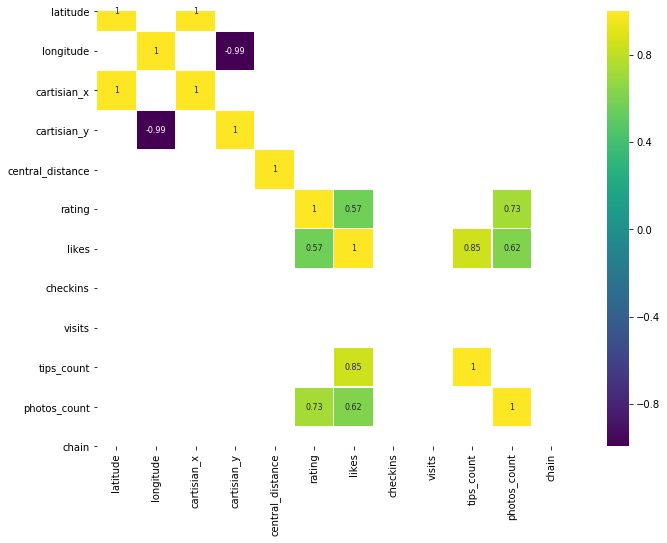

In [300]:
plt.figure(figsize=(13,8))
df_pred_corr = df_pred.corr()
sns.heatmap(df_pred_corr[(df_pred_corr >= 0.5) | (df_pred_corr <= -0.4)], annot=True, 
            cmap = 'viridis', square=True, annot_kws={"size":8}, linewidths=0.1)

We restricted our avaliation to more than 0.5 and less than -0.4 correlation. Geolocation WGS84 and UTM are strong correlated as expected. All relevants correlations are greenish.

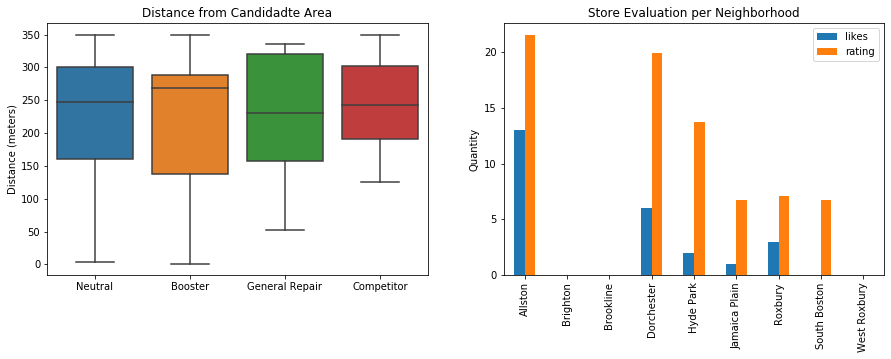

In [515]:
fig = plt.figure(figsize=(15,7))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)

ax1.set_title('Distance from Candidadte Area')
sns.boxplot(x=df['store_type'], y=df['central_distance'], ax=ax1)
ax1.set(xlabel='', ylabel='Distance (meters)')

df_pred[['neighborhood','likes', 'rating']].groupby('neighborhood').sum().plot(kind='bar', legend=True, ax=ax2)
ax2.set(ylabel='Quantity', xlabel='')
ax2.set_title('Store Evaluation per Neighborhood')

plt.subplots_adjust(top=1.5, bottom=0.4)
plt.show()

Two graphs were generated. The left graph compares the stores' distance to candidate areas, 50% of all stores are close 250 meters. 
The second graph is about how much active neighborhoods are into the platform. The most active users are located in Allston.

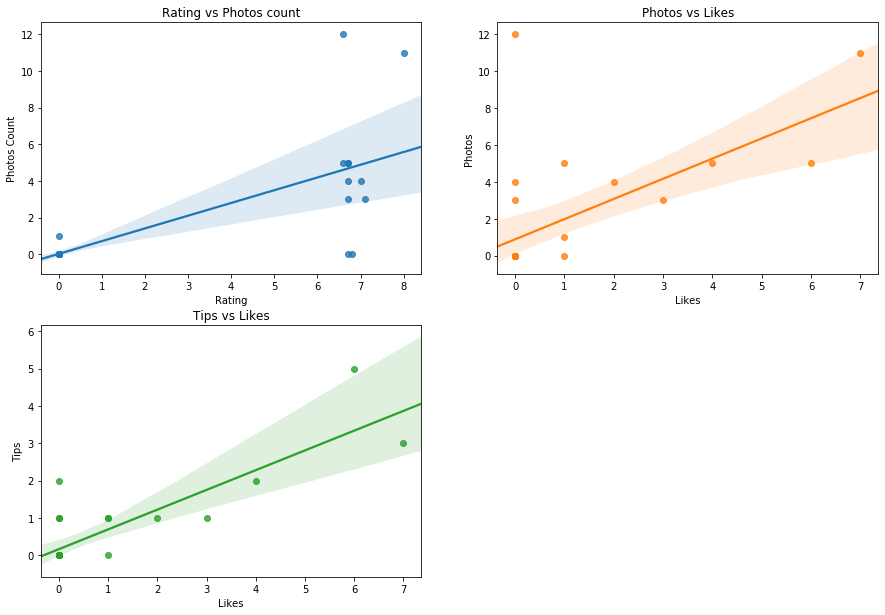

In [516]:
fig = plt.figure(figsize=(15,7))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)

ax1.set_title('Rating vs Photos count')
sns.regplot(x="rating", y="photos_count", data=df_pred, ax=ax1)
ax1.set(xlabel='Rating', ylabel='Photos Count')

ax2.set_title('Photos vs Likes')
sns.regplot(y=df_pred['photos_count'], x=df_pred['likes'], ax=ax2)
ax2.set(ylabel='Photos', xlabel='Likes')

ax3.set_title('Tips vs Likes')
sns.regplot(y=df_pred['tips_count'], x=df_pred['likes'], ax=ax3)
ax3.set(ylabel='Tips', xlabel='Likes')

plt.subplots_adjust(top=1.5, bottom=0.4)
plt.show()

We need more data to improve our analysis. But, as the Pearson correlation informed, there are some correlation into our data.

In [398]:
# one hot encoding
df_onehot = pd.get_dummies(df[['store_type','category']])

# add neighborhood column back to dataframe
df_onehot['neighborhood'] = df['neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [df_onehot.columns[-1]] + list(df_onehot.columns[:-1])
df_onehot = df_onehot[fixed_columns]

df_onehot.head(5)

,neighborhood,store_type_Booster,store_type_Competitor,store_type_General Repair,store_type_Neutral,category_ATM,category_Accessories Store,category_Afghan Restaurant,category_American Restaurant,category_Art Gallery,...,category_Video Store,category_Vietnamese Restaurant,category_Water Park,category_Wine Shop,category_Winery,category_Wings Joint,category_Women's Store,category_Yoga Studio,category_Zoo,category_Zoo Exhibit
0,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [593]:
#print('There are {} uniques categories.'.format(len(df['category'].unique())))

df_summed = df[['category', 'store_type']].groupby(['store_type']).aggregate('nunique').drop('store_type',1)
df_summed.columns = ['Total Category']
df_summed.index.name = 'Store Type'
df_summed.loc['TOTAL'] = df_summed['Total Category'].sum()
df_summed

There are 248 uniques categories.


,Total Category
Store Type,
Booster,7
Competitor,2
General Repair,3
Neutral,236
TOTAL,248


In [594]:
df_summed = df[['neighborhood','store_type','category']].groupby(['neighborhood', 'store_type'])\
                .aggregate('count').unstack().fillna(0)
df_summed.columns = ['booster', 'competitor', 'general repair', 'neutral']

df_summed = pd.merge(df_summed, census[['Name', 'Population', '20-34 years', '35-54 years']], 
         left_on='neighborhood', right_on='Name').sort_values(['competitor','booster','Population'], ascending=False)

cols = list(df_summed.columns)
cols.insert(0, cols.pop(cols.index('Name')))

df_summed = df_summed.loc[:, cols]
df_summed['20-34 years %'] = df_summed['20-34 years']/df_summed['Population']*100
df_summed['35-54 years %'] = df_summed['35-54 years']/df_summed['Population']*100

df_summed['20-34 years %'] = df_summed['20-34 years %'].apply(lambda x: round(x, 2))
df_summed['35-54 years %'] = df_summed['35-54 years %'].apply(lambda x: round(x, 2))

df_summed

,Name,booster,competitor,general repair,neutral,Population,20-34 years,35-54 years,20-34 years %,35-54 years %
2,Dorchester,5.0,4.0,5.0,334.0,125947,35301,32714,28.03,25.97
0,Allston,3.0,3.0,0.0,251.0,19363,13084,1711,67.57,8.84
7,Roxbury,3.0,2.0,0.0,106.0,52944,13886,12885,26.23,24.34
5,Hyde Park,2.0,2.0,3.0,103.0,37094,7725,9939,20.83,26.79
1,Brighton,1.0,2.0,0.0,208.0,51785,27399,8337,52.91,16.10
9,West Roxbury,7.0,1.0,4.0,222.0,33930,5847,9569,17.23,28.20
6,Jamaica Plain,3.0,1.0,0.0,180.0,39314,12991,10570,33.04,26.89
8,South Boston,0.0,1.0,0.0,47.0,36212,16456,8392,45.44,23.17
3,East Boston,0.0,0.0,0.0,8.0,46655,13673,14034,29.31,30.08
4,Fenway,0.0,0.0,0.0,60.0,32598,17097,3296,52.45,10.11


Text(0, 0.5, 'Neighborhood')

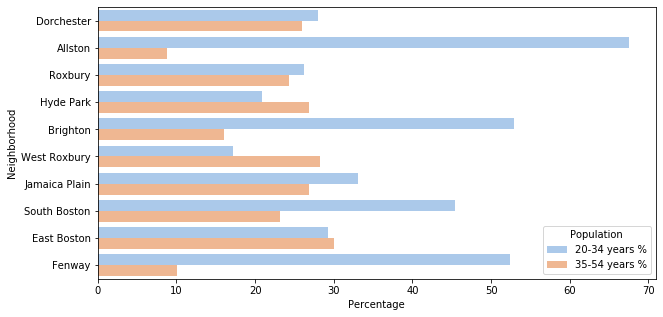

In [760]:
df_population = pd.melt(df_summed, id_vars=['Name'], value_vars=['20-34 years %','35-54 years %'], var_name='Population')

plt.figure(figsize=(10,5))
sns.barplot(x="value", y="Name", hue="Population", data=df_population, palette='pastel')
plt.xlabel('Percentage')
plt.ylabel('Neighborhood')

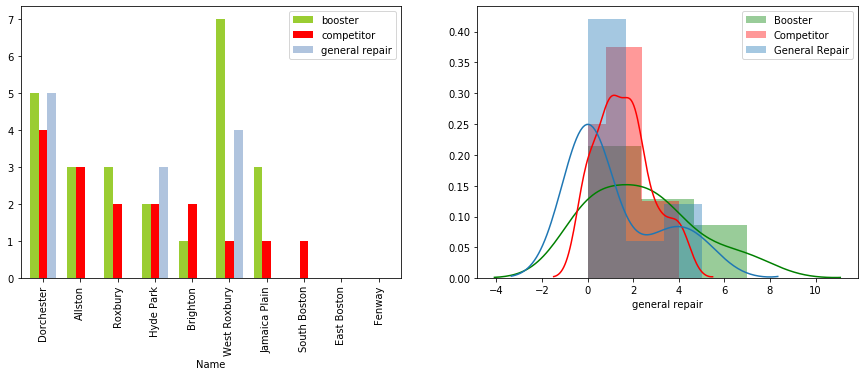

In [747]:
colors=['yellowgreen', 'red', 'lightsteelblue']

fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

df_summed[['Name', 'booster','competitor','general repair']].plot(kind='bar', x='Name', 
                                                                  color=colors, 
                                                                  #figsize=(8,5),
                                                                  width=.7, ax=ax1)

sns.distplot( df_summed["booster"], color="green", label="Booster", ax=ax2)
sns.distplot( df_summed["competitor"] , color="red", label="Competitor", ax=ax2)
sns.distplot( df_summed["general repair"], label="General Repair", ax=ax2)
plt.legend()



We see that, except for Allston, there's a correlation between population and the store's type. This study is not considering surrounding cities which would justify why Allston and is so high in the list.

Allston is close to many colleges and universities, and in recently, young professionals have moved to the area. These category of people have a tendency for technology. Also, it makes border with Fenway/Kenmore and Brighton, as well as three other cities.

In [401]:
# one hot encoding
df_onehot = pd.get_dummies(df[['store_type','category']])

# add neighborhood column back to dataframe
df_onehot['neighborhood'] = df['neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [df_onehot.columns[-1]] + list(df_onehot.columns[:-1])
df_onehot = df_onehot[fixed_columns]

df_onehot.head(5)

,neighborhood,store_type_Booster,store_type_Competitor,store_type_General Repair,store_type_Neutral,category_ATM,category_Accessories Store,category_Afghan Restaurant,category_American Restaurant,category_Art Gallery,...,category_Video Store,category_Vietnamese Restaurant,category_Water Park,category_Wine Shop,category_Winery,category_Wings Joint,category_Women's Store,category_Yoga Studio,category_Zoo,category_Zoo Exhibit
0,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,East Boston,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [761]:
df_grouped = df_onehot.groupby('neighborhood').mean()
df_grouped.head(5)

,store_type_Booster,store_type_Competitor,store_type_General Repair,store_type_Neutral,category_ATM,category_Accessories Store,category_Afghan Restaurant,category_American Restaurant,category_Art Gallery,category_Art Museum,...,category_Video Store,category_Vietnamese Restaurant,category_Water Park,category_Wine Shop,category_Winery,category_Wings Joint,category_Women's Store,category_Yoga Studio,category_Zoo,category_Zoo Exhibit
neighborhood,,,,,,,,,,,,,,,,,,,,,
Allston,0.011673,0.011673,0.000000,0.976654,0.003891,0.0,0.003891,0.003891,0.003891,0.000000,...,0.003891,0.007782,0.0,0.000000,0.0,0.000000,0.003891,0.007782,0.0,0.0
Beacon Street,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0
Brighton,0.004739,0.009479,0.000000,0.985782,0.004739,0.0,0.000000,0.004739,0.004739,0.004739,...,0.000000,0.000000,0.0,0.004739,0.0,0.004739,0.000000,0.004739,0.0,0.0
Brookline,0.083333,0.000000,0.083333,0.833333,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0
Cambridge,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0



Here, we calculate the **distance to the nearest Competitor from every area candidate center**, regardless of how distant it is.

In [452]:
def set_num_competitor(lat,lon):
    if (lat, lon) in competitors_to_central_loc:
        return competitors_to_central_loc[(lat, lon)]
    else: return 0

distances_to_competitors = []

for area_x, area_y in zip(xs, ys):
    min_distance = 10000
    for res in competitor_repairs.values():
        d = calc_xy_distance(area_x, area_y, res['cartisian_x'], res['cartisian_y'])
        if d<min_distance:
            min_distance = d
    distances_to_competitors.append(min_distance)

df_locations['Distance to Competitor'] = distances_to_competitors
df_locations['Competitor in Neighborhood'] = 0
    
competitors_to_central_loc = {}
for r in competitor_repairs.values():
    competitors_to_central_loc[r['central_point']] = competitors_to_central_loc.get(r['central_point'],0) +1
    
df_locations['Competitor in Neighborhood'] = df_locations[['Latitude','Longitude']]\
                                                .apply(lambda x: set_num_competitor(*x), axis=1)

df_locations.head(5)

,Address,Neigborhood,Borough,Zipcode,Latitude,Longitude,X,Y,Distance from City Center,Distance to Competitor,Competitor in Neighborhood
0,"86, Boardman Street, Orient Heights",East Boston,Suffolk County,02150,42.388556,-71.011085,-5.519218e+06,9.513308e+06,5378.972434,10000.00000,0
1,"295, Faywood Avenue, Orient Heights",East Boston,Suffolk County,02128,42.392198,-71.010579,-5.518618e+06,9.513308e+06,5813.400936,10000.00000,0
2,"370, William F McClellan Highway, Orient Heights",East Boston,Suffolk County,02150,42.390702,-71.015087,-5.518918e+06,9.513828e+06,5244.892316,10000.00000,0
3,"450, William F McClellan Highway, Orient Heights",East Boston,Suffolk County,02151,42.394344,-71.014581,-5.518318e+06,9.513828e+06,5710.283047,10000.00000,0
4,"University of Massachusetts Boston, 150, Mount...",South Boston,Suffolk County,02125,42.314918,-71.034169,-5.531518e+06,9.514867e+06,5995.431548,2738.40102,0


We concluded that **on average Competitors can be found within ~280m** from every area center candidate.

We'll load subway stations and identify locations with easy access to the system.

In [407]:
import zipfile
!wget 'http://transitdatatoolkit.com/wp-content/uploads/2019/03/mbta_stations.csv.zip' -O 'mbta_stations.csv.zip'

with zipfile.ZipFile("mbta_stations.csv.zip") as z:
    with z.open("mbta_stations.csv") as f:
      df_subway = pd.read_csv(f)

df_subway.head(5)

,OBJECTID,STATION,LINE,TERMINUS,ROUTE,LONGITUDE,LATITUDE
0,27,Airport,BLUE,N,Bowdoin to Wonderland,-71.030225,42.374371
1,25,Aquarium,BLUE,N,Bowdoin to Wonderland,-71.051939,42.359526
2,31,Beachmont,BLUE,N,Bowdoin to Wonderland,-70.992533,42.397260
3,23,Bowdoin,BLUE,Y,Bowdoin to Wonderland,-71.061838,42.361169
4,26,Maverick,BLUE,N,Bowdoin to Wonderland,-71.039580,42.369002


Let's create a map showing **heatmap / density** of **Competitors**, **General Repair**, and **Booster Neighbors** companies and try to extract some meaningful information from that. Also, we will show a few circles indicating distance of 5m, 7.5km, and 10km from City Center.

In [453]:
def boroughs_style(feature):
    return { 'color': 'blue', 'fill': False }

In [454]:
stores_latlons = [[res['latitude'], res['longitude']] for res in stores.values()]
general_repairs_latlons = [[res['latitude'], res['longitude']] for res in general_repair_shops.values()]
competitors_latlons = [[res['latitude'], res['longitude']] for res in competitor_repairs.values()]

In [410]:
from folium import plugins
from folium.plugins import HeatMap

map_boston = folium.Map(location=[latitude, longitude], zoom_start=12)
folium.TileLayer('cartodbpositron').add_to(map_boston) #cartodbpositron cartodbdark_matter
HeatMap(competitors_latlons).add_to(map_boston)
folium.Marker([latitude, longitude]).add_to(map_boston)
folium.Circle([latitude, longitude], radius=5000, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=7500, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=10000, fill=False, color='white').add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)
    
folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)

print('========= Competitors Shops ============')
map_boston

========= Competitors Shops ============


Looks like there is a competitor density close to the city center that can be found at **Allston-Brighton**. All remaining are located more than 7Km from the city center. A high number of competitors are placed **south-east Dorchester**.  

Let's create another heatmap map showing **heatmap/density of Booster Neighbors** only.

In [411]:
booster_neighbors_latlon = list(zip(df_booster_neighbors['latitude'], df_booster_neighbors['longitude']))

map_boston = folium.Map(location=[latitude, longitude], zoom_start=12)
folium.TileLayer('cartodbpositron').add_to(map_boston) #cartodbpositron cartodbdark_matter
HeatMap(booster_neighbors_latlon).add_to(map_boston)
folium.Marker([latitude, longitude]).add_to(map_boston)
folium.Circle([latitude, longitude], radius=5000, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=7500, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=10000, fill=False, color='white').add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)

print('============== Booster Neighbors nearby ==============')
map_boston

============== Booster Neighbors nearby ==============


We see that our supposed Booster Neighbors are very spread, but the two main concentrations, one in **Allston-Brigthon** and another in **West Roxbury**.  

Let's check General Repair Shops and try to understard visual patterns.

In [412]:
map_boston = folium.Map(location=[latitude, longitude], zoom_start=12)
folium.TileLayer('cartodbpositron').add_to(map_boston) #cartodbpositron cartodbdark_matter
HeatMap(general_repairs_latlons).add_to(map_boston)
folium.Marker([latitude, longitude]).add_to(map_boston)
folium.Circle([latitude, longitude], radius=5000, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=7500, fill=False, color='white').add_to(map_boston)
folium.Circle([latitude, longitude], radius=10000, fill=False, color='white').add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)
    
folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)

print('========== General Repair Shops ==============')
map_boston

========== General Repair Shops ==============


This map indicates a high density of General Repairs Shop **south Dorchester** away 10Km from the city center.

### Understanding Until Now<a name="understanding_until_now"></a>

Surrounding cities would be supporting and promoting shops in Allston-Birghton and south Dorchester neighborhoods. As result, their data could demonstrate wrong patterns, so more information is necessary to eliminate bag results.

Based on all insights and information so far we will focus our analysis into **Allston-Brigthon** and **Dorchester**. The central point will be moved to both regions with its radius size reduce to **2.5km**. Radius reduction narrows down the regions studied, likewise fits the range of 7.5Km-10Km shown onto heat maps.  

In the next step, we'll be studying both regions to get meaningful insights.

### Dorchester & Allston-Brighton Analysis<a name="dorchester_allstonbrighton"></a>

After a quick research on Internet, we could understandin characteristiccs of both neighborhoods, consequently, helped us improve our analysis.


**Dorchester**
Dorchester is Bost's most populous and largest neighborhood with approximately 126,000 residents spread around 6 square miles. filled with diversity and thriving families and active community organizations. It's considered the 4th largest city in the state.  

Due to its size, we can imagine two halves, north and south. The southern part of Dorchester is primarily a residential area and occupied by families for generations. The northern part of Dorchester is more urban, with a greater amount of apartment housing and industrial parks. South Bay Center and Newmarket industrial area are major sources of employment and the Harbor Point area is home of several large employers, including the Boston campus of the University of Massachusetts, the Massachusetts Archives and Commonwealth Museum, and more.

The neighborhood is served by five stations on the Red Line (MBTA) rapid transit service, and various bus routes. Mayor Marty Walsh proposed a budget for 2017 in which included is a five-year capital plan that is intended to make improvements to the infrastructure of Dorchester.

In Dorchester there are a lot of bars, restaurants, coffee shops, and parks. Many families and young professionals live in Dorchester and residents tend to be liberal.

**Allston-Brigton**  
Allston–Brighton is one of Boston's most vibrant neighborhoods. Allston Village, defined by Harvard Avenue, includes an eclectic blend of shops, venues, apartments, and people. Today the area is a middle-class urbanized area occupied largely by a mix of dense residential neighbourhoods and small businesses. However, both cities have its own postal zip codes.

Allston is generally understood as being in the northeast corner of Allston–Brighton meeting the commercialized Union Square area. 

Brighton is seen as the larger southwestern portion of Allston–Brighton encompassing Brighton Center and the generally less urbanized neighborhoods. Brigthon makes border with Cambridge, Watertown, Newton, and Brookline.  Washington Street runs through the center and is home to many small businesses. 
The Main Streets program aims to bring new shops and storefronts to the area.


Information source:
 - https://www.niche.com/
 - https://boston.curbed.com/
 - https://www.boston.gov/neighborhood
 - https://en.wikipedia.org/wiki/Allston
 - https://en.wikipedia.org/wiki/Dorchester


### Dorchester<a name="dorchester"></a>

First, let's define candidates areas into Dorchester.

In [413]:
boston_dorchester_lat, boston_dorchester_lon = 42.2936276079099, -71.0719932427939
boston_dorchester_x, boston_dorchester_y = lonlat_to_xy(boston_dorchester_lon, boston_dorchester_lat)

dorchester_roi_x_min = boston_dorchester_x - 2000
dorchester_roi_y_max = boston_dorchester_y + 2700
dorchester_roi_width = 5000
dorchester_roi_height = 5000
dorchester_roi_center_x = dorchester_roi_x_min + 3000
dorchester_roi_center_y = dorchester_roi_y_max - 3000

dorchester_roi_center_lon, dorchester_roi_center_lat = xy_to_lonlat(dorchester_roi_center_x, dorchester_roi_center_y)
dorchester_roi_center = [dorchester_roi_center_lat, dorchester_roi_center_lon]

k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells

dorchester_x_step = 150
dorchester_y_step = 150 * k 
dorchester_roi_y_min = dorchester_roi_center_y - 4500

dorchester_roi_latitudes = []
dorchester_roi_longitudes = []
dorchester_roi_xs = []
dorchester_roi_ys = []

for i in range(0, int(60/k)):
    y = dorchester_roi_y_min + i * dorchester_y_step
    x_offset = 60 if i%2==0 else 0
    
    for j in range(0, 60):
        x = dorchester_roi_x_min + j * dorchester_x_step + x_offset
        d = calc_xy_distance(dorchester_roi_center_x, dorchester_roi_center_y, x, y)
        
        if (d < 3001):
            lon, lat = xy_to_lonlat(x, y)
            dorchester_roi_latitudes.append(lat)
            dorchester_roi_longitudes.append(lon)
            dorchester_roi_xs.append(x)
            dorchester_roi_ys.append(y)

print(len(dorchester_roi_latitudes), 'candidate neighborhood centers generated.')

1454 candidate neighborhood centers generated.


Let's also create more dense grid of location candidates restricted to our new region of interest.

In [414]:
map_boston = folium.Map(location=dorchester_roi_center, zoom_start=14)
HeatMap(competitors_latlons).add_to(map_boston)
HeatMap(general_repairs_latlons).add_to(map_boston)
HeatMap(booster_neighbors_latlon).add_to(map_boston)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)
folium.Circle(dorchester_roi_center, radius=3000, color='white', fill=True, fill_opacity=0.4).add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)

print('============ Competitors, General Repair, and Booster Neighbors locations =================')
map_boston

============ Competitors, General Repair, and Booster Neighbors locations =================


Let's calculate two important things for each location candidate: **number of competitors in the vicinity** and **distance to the closest Booster Neighbor and General Repair Shop**.

In [415]:
def count_good_neighbors_nearby(x, y, shops, radius=250):  
    count = 0
    for res in shops.iterrows():
        d = calc_xy_distance(x, y, res[1]['cartisian_x'], res[1]['cartisian_y'])
        if d<=radius:
            count += 1
    return count

def find_nearest_competitors(x, y, shops):
    d_min = 100000
    for res in shops.values():
        d = calc_xy_distance(x, y, res['cartisian_x'], res['cartisian_y'])
        if d<=d_min:
            d_min = d
    return d_min

dorchester_roi_good_neighbors_counts = []
dorchester_roi_competitors_distances = []

dorchester_roi_booster_neighbors_counts = []
dorchester_roi_booster_neighbors_distances = []

dorchester_booster_neighbors = {}
for n in df_booster_neighbors.iterrows():
    idx = n[0]
    dorchester_booster_neighbors[idx] = {'id': idx, 
                                         'cartisian_x': n[1]['cartisian_x'], 
                                         'cartisian_y': n[1]['cartisian_y']}

print('Generating data on location candidates... ', end='')

for x, y in zip(dorchester_roi_xs, dorchester_roi_ys):
    count = count_good_neighbors_nearby(x, y, df_general_repair_shops, radius=350)
    dorchester_roi_good_neighbors_counts.append(count)
    distance = find_nearest_competitors(x, y, competitor_repairs)
    dorchester_roi_competitors_distances.append(distance)

for x, y in zip(dorchester_roi_xs, dorchester_roi_ys):
    count = count_good_neighbors_nearby(x, y, df_booster_neighbors, radius=350)
    dorchester_roi_booster_neighbors_counts.append(count)
    distance = find_nearest_competitors(x, y, competitor_repairs)
    dorchester_roi_booster_neighbors_distances.append(distance)    
    
print('done.')

Generating data on location candidates... done.


In [416]:
# Let's put this into dataframe
df_dorchester_roi_locations = pd.DataFrame({'Latitude': dorchester_roi_latitudes,
                                 'Longitude': dorchester_roi_longitudes,
                                 'X': dorchester_roi_xs,
                                 'Y': dorchester_roi_ys,
                                 'General Repair nearby': dorchester_roi_good_neighbors_counts,
                                 'Distance to Competitors': dorchester_roi_competitors_distances})

df_dorchester_roi_locations_booster = pd.DataFrame({'Latitude': dorchester_roi_latitudes,
                                         'Longitude': dorchester_roi_longitudes,
                                         'X': dorchester_roi_xs,
                                         'Y': dorchester_roi_ys,
                                         'Booster Neighbors nearby': dorchester_roi_booster_neighbors_counts,
                                         'Distance to Competitors': dorchester_roi_booster_neighbors_distances})

Let's now **filter** those locations we're interested in: 
 1. **Good locations close to Competitors:** location with no more than 3 competitors in a radius of 300 meters
 2. **Good locations close to Booster Neighbors**: location with at least 1 Booster Neighbor nearby and far up to 1200 meters from Competitors

In [417]:
print('================== Good Locations close to General Repair and Competitors ===================')
dorchester_good_res_count = np.array((df_dorchester_roi_locations['General Repair nearby']>=1))
print('Locations with none or more good neighbors nearby:', dorchester_good_res_count.sum())

dorchester_good_ita_distance = np.array(df_dorchester_roi_locations['Distance to Competitors']>=300)
print('Locations with no Competitor greater than or equal 300m:', dorchester_good_ita_distance.sum())

dorchester_good_locations = np.logical_and(dorchester_good_res_count, dorchester_good_ita_distance)
print('Locations with both conditions met:', dorchester_good_locations.sum())

df_dorchester_good_locations = df_dorchester_roi_locations[dorchester_good_locations]

print('\n==================  Good Locations close to Booster Neighbors and Competitors ===================')
dorchester_booster_res_count = np.array((df_dorchester_roi_locations_booster['Booster Neighbors nearby']>=1))
print('Locations with 1 or more Booster Neighbors nearby:', dorchester_booster_res_count.sum())

dorchester_booster_ita_distance = np.array(df_dorchester_roi_locations_booster['Distance to Competitors']<=1200)
print('Locations with Competitors within 1500m:', dorchester_booster_ita_distance.sum())

dorchester_booster_locations = np.logical_and(dorchester_booster_res_count, dorchester_booster_ita_distance)
print('Locations with both conditions met:', dorchester_booster_locations.sum())

df_dorchester_booster_locations = df_dorchester_roi_locations_booster[dorchester_booster_locations]

================== Good Locations close to General Repair and Competitors ===================
Locations with none or more good neighbors nearby: 23
Locations with no Competitor greater than or equal 300m: 1445
Locations with both conditions met: 22

==================  Good Locations close to Booster Neighbors and Competitors ===================
Locations with 1 or more Booster Neighbors nearby: 63
Locations with Competitors within 1500m: 251
Locations with both conditions met: 19


Let's see how this looks on a map.

In [419]:
# Good Neighbors
dorchester_good_latitudes = df_dorchester_good_locations['Latitude'].values
dorchester_good_longitudes = df_dorchester_good_locations['Longitude'].values
dorchester_good_locations = [[lat, lon] for lat, lon in zip(dorchester_good_latitudes, dorchester_good_longitudes)]

# Booster Neighbors 
dorchester_booster_latitudes = df_dorchester_booster_locations['Latitude'].values
dorchester_booster_longitudes = df_dorchester_booster_locations['Longitude'].values
dorchester_booster_locations = [[lat, lon] for lat, lon in zip(dorchester_booster_latitudes, dorchester_booster_longitudes)]

map_boston = folium.Map(location=dorchester_roi_center, zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_boston)
folium.Circle(dorchester_roi_center, radius=3000, color='white', fill=True, fill_opacity=0.6).add_to(map_boston)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)
HeatMap(competitors_latlons).add_to(map_boston)

for lat, lon in zip(dorchester_good_latitudes, dorchester_good_longitudes):
    folium.CircleMarker([lat, lon], radius=1, color='blue', fill=True).add_to(map_boston)
    
for lat, lon in zip(dorchester_booster_latitudes, dorchester_booster_longitudes):
    folium.CircleMarker([lat, lon], radius=1, color='black', fill=True).add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

We found that all locations are away from Dorchester Center, and each has no more than three competitors in a radius of 300 meters. Both blue and black points are potential candidates for a new Electronics Repair shop. Point colors are classified as: **blue** for locations close to General Repair shops, and **black** for locations close to booster neighbors.

Let's now show those good locations in a form the heatmap.

In [422]:
map_boston = folium.Map(location=dorchester_roi_center, zoom_start=13)

HeatMap(dorchester_booster_locations, radius=25).add_to(map_boston)
HeatMap(dorchester_good_locations, radius=25).add_to(map_boston)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)

for lat, lon in competitors_latlons:
    folium.CircleMarker([lat, lon], radius=4, color='red', fill=True, fill_color='red', fill_opacity=1).add_to(map_boston)
    
for lat, lon in zip(dorchester_good_latitudes, dorchester_good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_boston)

for lat, lon in zip(dorchester_booster_latitudes, dorchester_booster_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='black', fill=True, fill_color='yellow', fill_opacity=1).add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

What we have now is a clear indication of zones with low number of Competitors in the vicinity with Booster or General Repair shop nearby. Point colors are classified as: **red** for Competitors, **blue** for locations close to General Repair shops and **black** for locations close to Booster neighbors.

Let us now **cluster** those locations in order to create **centers of zones containing for good locations**.

### Allston-Brighton<a name="allston_brighton"></a>

Now, we'll repeat all procedures we've done for Dorchester.

In [423]:
boston_allston_lat, boston_allston_lon = 42.3500971, -71.1434423
boston_allston_x, boston_allston_y = lonlat_to_xy(boston_allston_lon, boston_allston_lat)

allston_roi_x_min = boston_allston_x - 2000 # old: 2000
allston_roi_y_max = boston_allston_y + 2000 # old: 2000
allston_roi_width = 3000
allston_roi_height = 3000
allston_roi_center_x = allston_roi_x_min + 2000 # old 2500
allston_roi_center_y = allston_roi_y_max - 2000 # old 2500

allston_roi_center_lon, allston_roi_center_lat = xy_to_lonlat(allston_roi_center_x, allston_roi_center_y)
allston_roi_center = [allston_roi_center_lat, allston_roi_center_lon]

k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells

allston_x_step = 250
allston_y_step = 250 * k 
allston_roi_y_min = allston_roi_center_y - 4500 # old 4500

allston_roi_latitudes = []
allston_roi_longitudes = []
allston_roi_xs = []
allston_roi_ys = []

boston_allston_shapes = list()

with open(boston_geo_file,'r') as f:
    js = json.load(f)
    
for features in js['features']:
    if features['properties']['Name'] in ('Allston', 'Brighton'):
        poly = shape(features['geometry'])
        boston_allston_shapes.append(poly)        
        
for i in range(0, int(51/k)):
    y = allston_roi_y_min + i * allston_y_step
    x_offset = 41 if i%2==0 else 0
    
    for j in range(0, 51):
        x = allston_roi_x_min + j * allston_x_step + x_offset
        d = calc_xy_distance(allston_roi_center_x, allston_roi_center_y, x, y)
        
        if (d < 4001):
            lon, lat = xy_to_lonlat(x, y)
                        
            point = Point(lon, lat)
            inside_allston = False
            # check if the coordinate is inside the Allston-Brighton radius, if true
            # the coordinate will be discarded
            for state in boston_allston_shapes:
                if state.contains(point):
                    inside_allston = True

            if not inside_allston:
                continue

            allston_roi_latitudes.append(lat)
            allston_roi_longitudes.append(lon)
            allston_roi_xs.append(x)
            allston_roi_ys.append(y)

print(len(allston_roi_latitudes), 'candidate neighborhood centers generated.')

420 candidate neighborhood centers generated.


In [424]:
map_boston = folium.Map(location=allston_roi_center, zoom_start=14)
HeatMap(competitors_latlons).add_to(map_boston)
HeatMap(general_repairs_latlons).add_to(map_boston)
HeatMap(booster_neighbors_latlon).add_to(map_boston)

folium.Marker([boston_allston_lat, boston_allston_lon]).add_to(map_boston)
folium.Circle(allston_roi_center, radius=2500, color='white', fill=True, fill_opacity=0.4).add_to(map_boston)
folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)

print('============ Competitors, General Repair, and Booster Neighbors Data =================')
map_boston

============ Competitors, General Repair, and Booster Neighbors Data =================


In [425]:
allston_roi_good_neighbors_counts = []
allston_roi_competitors_distances = []

allston_roi_booster_neighbors_counts = []
allston_roi_booster_neighbors_distances = []

allston_booster_neighbors = {}
for n in df_booster_neighbors.iterrows():
    idx = n[0]
    allston_booster_neighbors[idx] = {'id': idx, 
                                     'cartisian_x': n[1]['cartisian_x'], 
                                     'cartisian_y': n[1]['cartisian_y']}

print('Generating data on location candidates... ', end='')

for x, y in zip(allston_roi_xs, allston_roi_ys):
    count = count_good_neighbors_nearby(x, y, df_general_repair_shops, radius=150)
    allston_roi_good_neighbors_counts.append(count)
    distance = find_nearest_competitors(x, y, competitor_repairs)
    allston_roi_competitors_distances.append(distance)

for x, y in zip(allston_roi_xs, allston_roi_ys):
    count = count_good_neighbors_nearby(x, y, df_booster_neighbors, radius=150)
    allston_roi_booster_neighbors_counts.append(count)
    distance = find_nearest_competitors(x, y, competitor_repairs)
    allston_roi_booster_neighbors_distances.append(distance)    
    
print('done.')

Generating data on location candidates... done.


In [426]:
# Let's put this into dataframe
df_allston_roi_locations = pd.DataFrame({'Latitude': allston_roi_latitudes,
                                 'Longitude': allston_roi_longitudes,
                                 'X': allston_roi_xs,
                                 'Y': allston_roi_ys,
                                 'General Repair nearby': allston_roi_good_neighbors_counts,
                                 'Distance to Competitors': allston_roi_competitors_distances})

df_allston_roi_locations_booster = pd.DataFrame({'Latitude': allston_roi_latitudes,
                                         'Longitude': allston_roi_longitudes,
                                         'X': allston_roi_xs,
                                         'Y': allston_roi_ys,
                                         'Booster Neighbors nearby': allston_roi_booster_neighbors_counts,
                                         'Distance to Competitors': allston_roi_booster_neighbors_distances})

In [427]:
print('================== Good Locations close to General Repair and Competitors ===================')
allston_good_res_count = np.array((df_allston_roi_locations['General Repair nearby']>=0))
print('Locations with none or more good neighbors nearby:', allston_good_res_count.sum())

allston_good_ita_distance = np.array(df_allston_roi_locations['Distance to Competitors']>=300)
print('Locations with no Competitor greater than or equal 300m:', allston_good_ita_distance.sum())

allston_good_locations = np.logical_and(allston_good_res_count, allston_good_ita_distance)
print('Locations with both conditions met:', allston_good_locations.sum())

df_allston_good_locations = df_allston_roi_locations[allston_good_locations]

print('\n==================  Good Locations close to Booster Neighbors and Competitors ===================')
allston_booster_res_count = np.array((df_allston_roi_locations_booster['Booster Neighbors nearby']>=0))
print('Locations with none or more Booster Neighbors nearby:', allston_booster_res_count.sum())

allston_booster_ita_distance = np.array(df_allston_roi_locations_booster['Distance to Competitors']>300)
print('Locations with Competitors within 300m:', allston_booster_ita_distance.sum())

allston_booster_locations = np.logical_and(allston_booster_res_count, allston_booster_ita_distance)
print('Locations with both conditions met:', allston_booster_locations.sum())

df_allston_booster_locations = df_allston_roi_locations_booster[allston_booster_locations]

================== Good Locations close to General Repair and Competitors ===================
Locations with none or more good neighbors nearby: 420
Locations with no Competitor greater than or equal 300m: 398
Locations with both conditions met: 398

==================  Good Locations close to Booster Neighbors and Competitors ===================
Locations with none or more Booster Neighbors nearby: 420
Locations with Competitors within 300m: 398
Locations with both conditions met: 398


In [428]:
# Good Neighbors
allston_good_latitudes = df_allston_good_locations['Latitude'].values
allston_good_longitudes = df_allston_good_locations['Longitude'].values
allston_good_locations = [[lat, lon] for lat, lon in zip(allston_good_latitudes, allston_good_longitudes)]

# Booster Neighbors 
allston_booster_latitudes = df_allston_booster_locations['Latitude'].values
allston_booster_longitudes = df_allston_booster_locations['Longitude'].values
allston_booster_locations = [[lat, lon] for lat, lon in zip(allston_booster_latitudes, allston_booster_longitudes)]

map_boston = folium.Map(location=allston_roi_center, zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_boston)
folium.Circle(allston_roi_center, radius=3000, color='white', fill=True, fill_opacity=0.6).add_to(map_boston)
folium.Marker([boston_allston_lat, boston_allston_lon]).add_to(map_boston)
HeatMap(competitors_latlons).add_to(map_boston)

for lat, lon in zip(allston_good_latitudes, allston_good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True).add_to(map_boston)
    
for lat, lon in zip(allston_booster_latitudes, allston_booster_longitudes):
    folium.CircleMarker([lat, lon], radius=1, color='yellow', fill=True).add_to(map_boston)
    
folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

This map reflects two important points, the first observation is that we need more information about the companies from both neighborhoods - Allston and Brighton. The second point is concerned about surrounding cities - Newton, Cambridge, Watertown, Brookline, and Chectnut Hill - have been empowering their local businesses. As depicted in the map, the white radius covers all neighbors cities and blue and yellow points are overlapping each other.

## Clustering<a name="clustering"></a>
This is the final step. We'll explore the cluster and try to math a pattern with ours exploratory data analysis.

In [501]:
from sklearn.cluster import KMeans

predict_coord = pd.concat([df_booster_neighbors[['cartisian_x','cartisian_y']],
                            df_pred[['cartisian_x','cartisian_y']]], ignore_index=True)

#X = df[['cartisian_x','cartisian_y']].values                 
X = predict_coord[['cartisian_x','cartisian_y']].values

k_num = range(1, 20)
kmean = [KMeans(n_clusters=i).fit(X) for i in k_num]

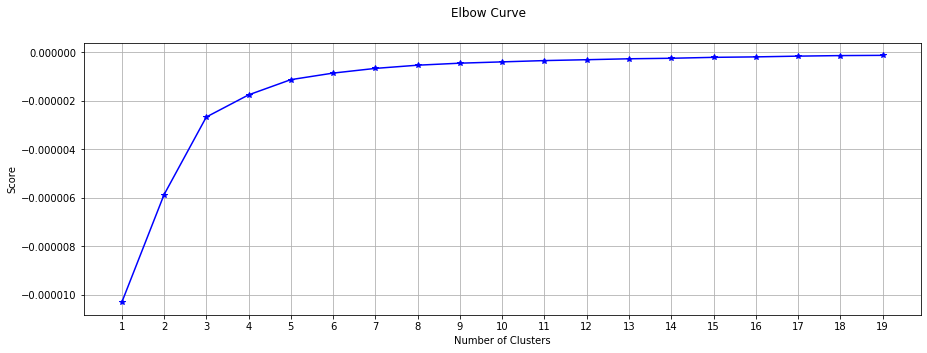

In [502]:
X_norm = (X - X.mean()) / (X.max() - X.min())
score = [kmean[i].fit(X_norm).score(X_norm) for i in range(len(kmean))]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 5))
fig.suptitle('Elbow Curve')
plt.plot(k_num,score, 'b*-')
plt.grid(b=True, linestyle='-')
plt.xticks(k_num)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.show()

The Elbow curve shows an high move from 1 to 4 and reducing its improvement, when 8 is reached the advance reduces sharply and we cannot see any new performance. Let's analyze 6 and 8 clusters.

### K-means Clustering Simulation - k=8
Simulate the clustering with 8 cluster.

In [503]:
k_num_best = 8
kmean = KMeans(n_clusters=k_num_best).fit(X)
cluster_centers = [xy_to_lonlat(cc[0], cc[1]) for cc in kmean.cluster_centers_]

In [2]:
map_boston = folium.Map(location=dorchester_roi_center, zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_boston)
HeatMap(competitors_latlons).add_to(map_boston)
folium.Circle(dorchester_roi_center, radius=2500, color='white', fill=True, fill_opacity=0.4).add_to(map_boston)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)

for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=300, color='green', fill=True, fill_opacity=0.25).add_to(map_boston) 

for lat, lon in zip(dorchester_good_latitudes, dorchester_good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_boston)

for lat, lon in zip(dorchester_booster_latitudes, dorchester_booster_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='black', fill=True, fill_color='black', fill_opacity=1).add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

### K-means Clustering Simulation - k=6
Simluate the clustering using 6 clusters.

In [507]:
k_num_best = 6
kmean = KMeans(n_clusters=k_num_best).fit(X)
cluster_centers = [xy_to_lonlat(cc[0], cc[1]) for cc in kmean.cluster_centers_]

In [508]:
map_boston = folium.Map(location=dorchester_roi_center, zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_boston)
HeatMap(competitors_latlons).add_to(map_boston)
folium.Circle(dorchester_roi_center, radius=2500, color='white', fill=True, fill_opacity=0.4).add_to(map_boston)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)

for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=300, color='green', fill=True, fill_opacity=0.25).add_to(map_boston) 

for lat, lon in zip(dorchester_good_latitudes, dorchester_good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_boston)

for lat, lon in zip(dorchester_booster_latitudes, dorchester_booster_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='black', fill=True, fill_color='yellow', fill_opacity=1).add_to(map_boston)

for lat, lon in zip(df_subway['LATITUDE'], df_subway['LONGITUDE']):
    folium.Circle([lat, lon], radius=3, color='#d816c6').add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

Our clusters represent grouping of the most candidate location. Cluster centers are placed nicely in the middle of the zones with location candidates. Addresses of those clusters will be a good starting point for exploring the neighborhoods and find the best possible location.

Let's see those zones on a city map without heatmap, using shaded areas to indicate our clusters:

In [509]:
# We had to split the code because wen Circle overlaps CircleMarker we cannot visualize the coordinates of each point

map_boston = folium.Map(location=dorchester_roi_center, zoom_start=14)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon], popup="Dorchester Center").add_to(map_boston)

num_good_locations = len(dorchester_good_locations)

# General Repair Shops 
for seq, coordinate in enumerate(itertools.chain(dorchester_good_locations, dorchester_booster_locations)):
    color = '#0066ff' if seq < num_good_locations else 'd2d2d2'
    folium.Circle(coordinate, radius=250, color='#00000000', fill=True, fill_color=color, fill_opacity=0.07).add_to(map_boston)   
    
# Booster Neighbors
for seq, coordinate in enumerate(itertools.chain(dorchester_good_locations, dorchester_booster_locations)):
    color = 'blue' if seq < num_good_locations else 'black'
    folium.CircleMarker(coordinate, radius=2, color=color,
                        popup="""Latitude: {}<br>Longitude: {}""".format(coordinate[0], coordinate[1]),
                        fill=True, fill_color=color, fill_opacity=1).add_to(map_boston)

for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=300, color='green', fill=False).add_to(map_boston) 

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)    
map_boston

Let's zoom in on candidate areas in **Dorchester**:

In [510]:
map_boston = folium.Map(location=[42.29263379477612, -71.0507584999622], zoom_start=16)
folium.Marker([boston_dorchester_lat, boston_dorchester_lon]).add_to(map_boston)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=300, color='green', fill=False).add_to(map_boston) 
for lat, lon in dorchester_good_locations:
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.07).add_to(map_boston)
for lat, lon in dorchester_good_locations:
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_boston)

folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

...and candidate Booster Neighbor area in **Dorchester-Roxbury**:

In [511]:
map_boston = folium.Map(location=[42.31487751313402, -71.077713261129], zoom_start=16)
folium.Marker([latitude, longitude]).add_to(map_boston)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=False).add_to(map_boston) 
for lat, lon in dorchester_booster_locations:
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='d2d2d2', fill_opacity=0.07).add_to(map_boston)
for lat, lon in dorchester_booster_locations:
    folium.CircleMarker([lat, lon], radius=2, color='black', fill=True, fill_color='black', fill_opacity=1).add_to(map_boston)
folium.GeoJson(boston_geo, style_function=boroughs_style, name='geojson').add_to(map_boston)
map_boston

Finaly, let's **reverse geocode those candidate area centers to get the addresses** which can be presented to stakeholders.

In [512]:
candidate_area_addresses = []
print('==============================================================')
print('Addresses of Centers of Areas recommended for Further Analysis')
print('==============================================================\n')
for lon, lat in cluster_centers:
    addr = get_address(lat, lon).replace(', United States of America', '').replace(', United States', '')
    addr = addr.replace(', Boston', '').replace(', Massachusetts', '').replace(', MA', '')
    
    x, y = lonlat_to_xy(lon, lat)
    d = calc_xy_distance(x, y, boston_center_x, boston_center_y)
    addr = addr.split(', ')
    candidate_area_addresses.append((addr[0], " ".join(addr[1:len(addr)-3]), 
                                     addr[-3], addr[-2], addr[-1], "{:.2f}".format(d/1000),
                                     lat, lon))
    
candidate_area_addresses = pd.DataFrame(candidate_area_addresses)
candidate_area_addresses.columns = ['Number', 'Address', 'Neighborhood', 'Borough', 'Zipcode', 
                                    'Distance from Boston (Km)', 'Latitude', 'Longitude']
candidate_area_addresses

Addresses of Centers of Areas recommended for Further Analysis



,Number,Address,Neighborhood,Borough,Zipcode,Distance from Boston (Km),Latitude,Longitude
0,229A,River Street Mattapan,Dorchester,Suffolk County,02126,14.26,42.275397,-71.083587
1,40,North Beacon Street North Brighton,Allston,Suffolk County,02135,9.95,42.353739,-71.139593
2,86,Bradlee Street Clarendon Hills,Hyde Park,Suffolk County,02131-4931,16.45,42.270279,-71.117840
3,27,Dixwell Street Roxbury Crossing,Roxbury,Suffolk County,02130-0947,8.87,42.314691,-71.097500
4,149,Park Street Highland,West Roxbury,Suffolk County,02132,17.15,42.283886,-71.154429
5,3,North Munroe Terrace Fields Corner,Dorchester,Suffolk County,01210,11.04,42.293186,-71.051409


This concludes our analysis. We have created 15 addresses representing centers of zones containing locations with low number of competitors and the great number as possible of general repair companies.

The cluster identify as **North Munroe Terrace Fields Corner, Dorchester, Suffolk County, 01210** was the location where the clustering and data analysis predicted, it shold be a deserve deeper analysis. In addition, the cluster located at **Dixwell Street Roxbury Crossing, Roxbury** was close enough to also deserve be studied.

Zones well-spread and distant from downtown raging from 7.4Km to 19.73Km away. Although zones are shown on map with a radius of **~300 meters** (green circles), their shape is actually very irregular and their centers/addresses should be considered only as a starting point for exploring area neighborhoods in search for potential shop locations. Also we one zone in Allston and another in Brigthon close to competitors that should checked as they are interesting due to being popular with young adult and near Boston downton, besides make bourder with four others cities and well connected by public transport.

In [526]:
map_boston = folium.Map(location=dorchester_roi_center, zoom_start=13)
folium.Circle([latitude, longitude], radius=50, color='red', fill=True, fill_color='red', fill_opacity=1).add_to(map_boston)

for loc in candidate_area_addresses.iterrows():
    popuptext="""<b>Address: </b>{}</br>
                 <b>Zipcode: </b>{}</br>
                 <b>Neighborhood: </b>{}</br>
                 <b>Borough: </b>{}</br>
                 <b>Distance from Boston: </b>{}Km</br>""".format(loc[1]['Address'], loc[1]['Zipcode'], 
                                                                loc[1]['Neighborhood'], loc[1]['Borough'], 
                                                                loc[1]['Distance from Boston (Km)'])
    test = folium.Html(popuptext, script=True)
    
    folium.Marker([loc[1]['Latitude'], loc[1]['Longitude']], 
                  popup=folium.Popup(test, max_width=300,min_width=200)).add_to(map_boston) 

for loc in candidate_area_addresses.iterrows():
    lat = loc[1]['Latitude']
    lon = loc[1]['Longitude']
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.09).add_to(map_boston)
map_boston

## Results and Discussion <a name="results"></a>

Our analysis has shown that the number of competitors in Boston away from the city center (with more than 5Km from downtown) is extremely low. Outsite Downton the number of competitors is low and most are concentrated in South Dorchester. Two neighborhoods were identified, Dorchester and Allston, but we focused on Dorchester which offered a greater combination of competitors, booster neighbors, public transportation, general repair shop, and population number. The low number of data from Allston still puts the neighborhood as a very likely candidate.

After directing our attention to this more narrow area of interest (covering approx. 2.5x2.5km south Dorchester) we first created a dense grid of location candidates (spaced 600m appart); those locations were then filtered so that those with more than three competitors in a radius of 250m were removed. In addition, we found out that booster neighbors and competitors are walking together through neighborhoods. 

Those location candidates were then clustered to create zones of interest that contain the greatest number of location candidates. Addresses of centers of those zones were also generated using reverse geocoding to be used as markers/starting points for more detailed local analysis based on other factors.

Result of all this is 6 zones containing the largest number of potential new electronics repair store locations based on the number of and distance to existing venues. Those zones do not imply optimal locations for a new electronics repair. The purpose of this analysis was to only provide information on areas away from the city center and no crowded with existing competitors and close to booster neighbors. Recommended zones should, therefore, be considered only as a starting point for more detailed analysis which could eventually result in location which has not only no nearby competition but also other factors taken into account and all other relevant conditions met.

## Conclusion <a name="conclusion"></a>

The purpose was to identify areas away from Boston's city center with a small number or zero electronics repair shops. Calculating electronics repair density distribution from Foursquare data we first identified neighbors that justify further analysis (Dorchester and Allston-Bright). However, Allston deserves great attention too, its low number of features and small size produced an indeterminant result which does not reflect potential surrounding cities.

In Dorchester a small area composed of three regions which satisfy business requirements that could booster our business was pretty accurate with the clustering results, contributed in three zones that contain great potential and should be used as starting points for final exploration by investors.

A further step should visit those locations and see their movement and attractiveness such as easy parking, renting prices, building space. Those characteristics could attract and repel customers and make the business impractable.